<a href="https://colab.research.google.com/github/marimcmurtrie/deep_learning_cnn/blob/main/mari_project_image_dog_01_2025.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Project

1. Import Libraries
2. Obtain data
3. Examine data
4. Create datasets
5. Normalize data
6. Create a model
7. Train the model
8. Visualize the training performance
9. Fix Overfitting - data augumentation
10. Fix Overfitting - dropout
11. Train the model again
12. Visualize the training performance
13. Compare performance







## 1: Import Libraries

In [ ]:
import matplotlib.pyplot as plt
import numpy as np
import PIL
import tensorflow as tf
import os

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
import pathlib

## 2: Download Data


In [ ]:
dataset_url = "http://vision.stanford.edu/aditya86/ImageNetDogs/images.tar"
root_data_dir = tf.keras.utils.get_file('dog_images.tar', origin=dataset_url, extract=True)

root_data_dir = pathlib.Path(root_data_dir).with_suffix('')
print(root_data_dir)

793579520/793579520 ━━━━━━━━━━━━━━━━━━━━ 57s 0us/step
/root/.keras/datasets/dog_images_extracted


In [ ]:
data_dir = root_data_dir / 'Images'
print(data_dir)
dog_breed_count = len(list(data_dir.glob('*')))
print(f"{dog_breed_count = }")

for child in data_dir.iterdir():
  print(child.name)


/root/.keras/datasets/dog_images_extracted/Images
dog_breed_count = 120
n02108422-bull_mastiff
n02109047-Great_Dane
n02097047-miniature_schnauzer
n02085782-Japanese_spaniel
n02102177-Welsh_springer_spaniel
n02104365-schipperke
n02107683-Bernese_mountain_dog
n02100735-English_setter
n02092002-Scottish_deerhound
n02113712-miniature_poodle
n02107908-Appenzeller
n02100236-German_short-haired_pointer
n02111129-Leonberg
n02108915-French_bulldog
n02093754-Border_terrier
n02092339-Weimaraner
n02111889-Samoyed
n02112706-Brabancon_griffon
n02105855-Shetland_sheepdog
n02106030-collie
n02107142-Doberman
n02116738-African_hunting_dog
n02101388-Brittany_spaniel
n02085620-Chihuahua
n02110185-Siberian_husky
n02097209-standard_schnauzer
n02112018-Pomeranian
n02088632-bluetick
n02106662-German_shepherd
n02096177-cairn
n02091467-Norwegian_elkhound
n02086910-papillon
n02113799-standard_poodle
n02085936-Maltese_dog
n02091635-otterhound
n02112137-chow
n02115641-dingo
n02098105-soft-coated_wheaten_terrier
n0

## 3: Examine data

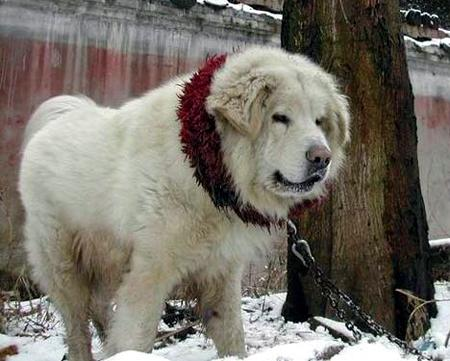

In [ ]:
border_collies = list(data_dir.glob('./n02108551-Tibetan_mastiff/*'))
PIL.Image.open(str(border_collies[0]))

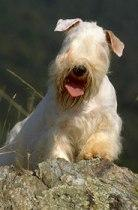

In [ ]:
german_short_hairs = list(data_dir.glob('./n02095889-Sealyham_terrier/*'))
PIL.Image.open(str(german_short_hairs[0]))

As we can see, the images sizes vary. Also, a position of dog in a image is not centered.

## Clean Images
The images are different sizes. Also, a dog in image is not centered.
We need to crop images so that the image contains only a dog, if possible

In [ ]:
annotation_url = "http://vision.stanford.edu/aditya86/ImageNetDogs/annotation.tar"
annotation_root_data_dir = tf.keras.utils.get_file('annotation.tar', origin=annotation_url, extract=True)
annotation_root_data_dir = pathlib.Path(annotation_root_data_dir).with_suffix('')
print(annotation_root_data_dir)

21852160/21852160 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step
/root/.keras/datasets/annotation_extracted


In [ ]:
annotation_dir = annotation_root_data_dir / 'Annotation'
annotation_count = len(list(annotation_dir.glob('*')))
print(f"{annotation_count = }")  #120, the same as dog bleed count

# for child in annotation_dir.iterdir():
  # match = re.search('(n\d+-)(.*)', child.name)
  # child.rename(annotation_dir / match.group(2))
  # print(child)

annotation_count = 120


In [37]:
import xml.etree.ElementTree as ET
from PIL import Image

# Read original image files and its annotations. Cut the image to its boundary size and make tumbnail.
def readImageAndAnnotationFiles(root_data_dir, data_dir, annotation_dir):
    all_images = os.listdir(data_dir)
    all_annotations = os.listdir(annotation_dir)
    #print(all_images)
    if len(all_images) != len(all_annotations):
        raise Exception('should not happen')

    for i in range(len(all_images)):
        image_directory_name = all_images[i]
        image_files = os.listdir(data_dir / image_directory_name)
        image_files.sort()
        # print(image_files)

        annotation_directory_name = all_annotations[i]
        annotation_files = os.listdir(annotation_dir / annotation_directory_name)
        annotation_files.sort()

        if len(image_files) != len(annotation_files):
            raise Exception('should not happen')

        for j in range(len(image_files)):
            an_image = image_files[j]
            an_annotation = annotation_files[j]
            image = data_dir / image_directory_name / an_image
            annotation = annotation_dir / annotation_directory_name / an_annotation
            cropImageWithAnnotationData(j, image, annotation)


def cropImageWithAnnotationData(nth, image, annotation):
    #First, parse annotation file to get info of an image.
    tree = ET.parse(annotation)
    root = tree.getroot()
    width = root.find('size/width')
    height = root.find('size/height')
    bounding_x_min = root.find('object/bndbox/xmin')
    bounding_y_min = root.find('object/bndbox/ymin')
    bounding_x_max = root.find('object/bndbox/xmax')
    bounding_y_max = root.find('object/bndbox/ymax')
    dog_name = root.find('object/name')
#     print(dog_name.text)
#     print(bounding_x_min.text,bounding_y_min.text,bounding_x_max.text,bounding_y_max.text)

    bounding_x_min_val = (int)(bounding_x_min.text)
    bounding_y_min_val = (int)(bounding_y_min.text)
    bounding_x_max_val = (int)(bounding_x_max.text)
    bounding_y_max_val = (int)(bounding_y_max.text)

    #Crop the image
    im_original = Image.open(image)
    im_cropped = im_original.crop((bounding_x_min_val, bounding_y_min_val, bounding_x_max_val, bounding_y_max_val))

    #Save the cropped
    dest = root_data_dir / 'AllImages' / dog_name.text
    if not os.path.isdir(dest):
        os.makedirs(dest)

    # size = (128, 128)
    # im_cropped.thumbnail(size)
    outfile = dest / f"image_{nth}.png"
    im_cropped.save(outfile)

    if nth == 0:
      print(dog_name.text)
      # imgplot = plt.imshow(im_original)
      # plt.show()
      imgplot = plt.imshow(im_cropped)
      plt.show()




bull_mastiff


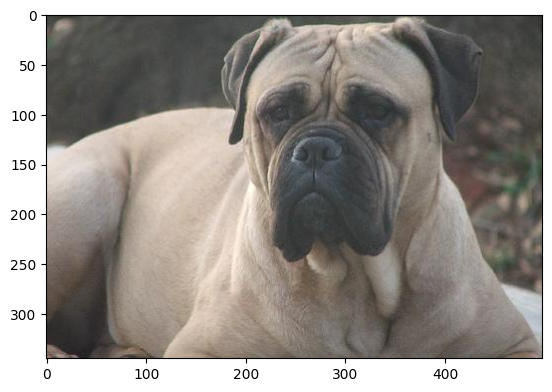

Great_Dane


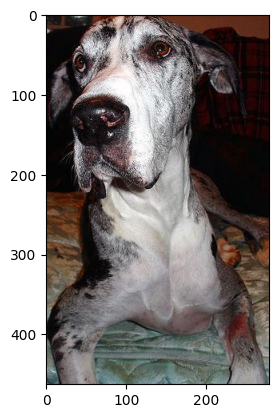

miniature_schnauzer


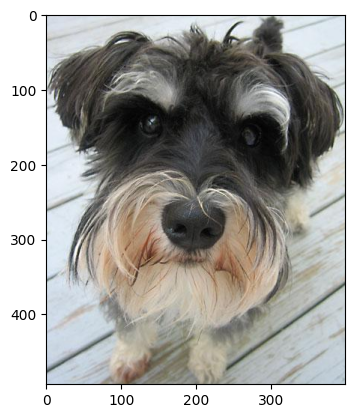

Japanese_spaniel


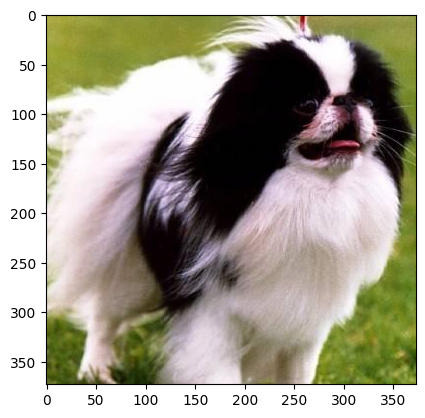

Welsh_springer_spaniel


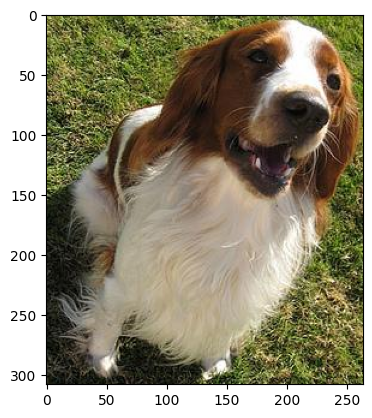

schipperke


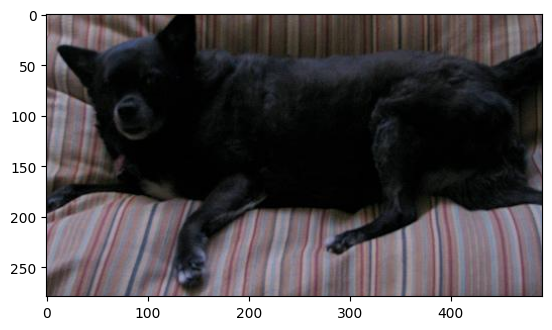

Bernese_mountain_dog


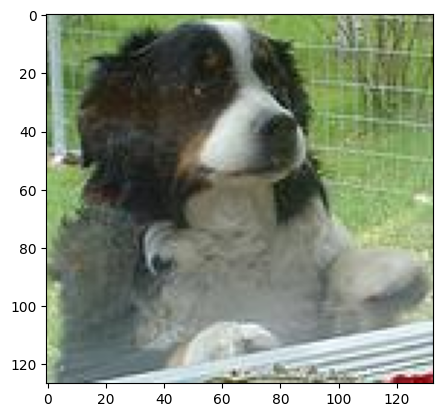

English_setter


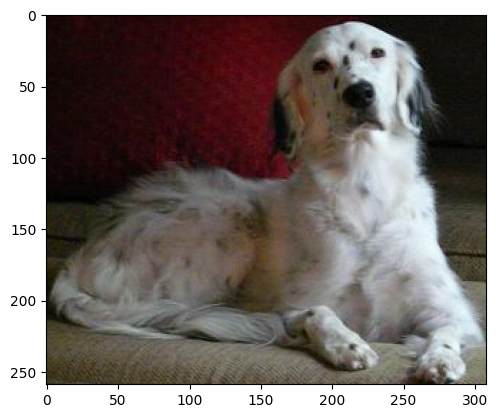

Scottish_deerhound


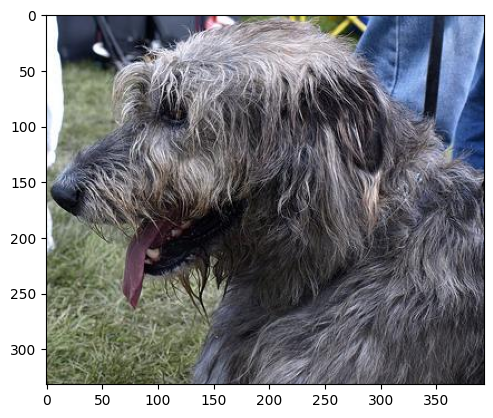

miniature_poodle


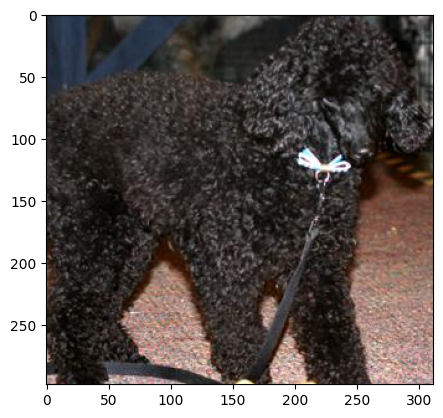

Appenzeller


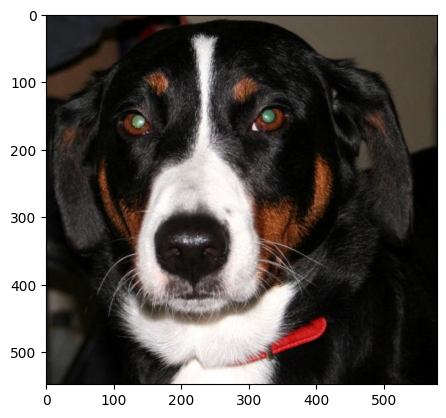

German_short-haired_pointer


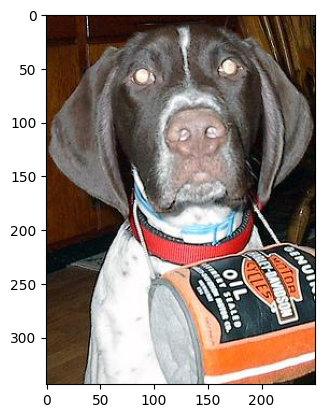

Leonberg


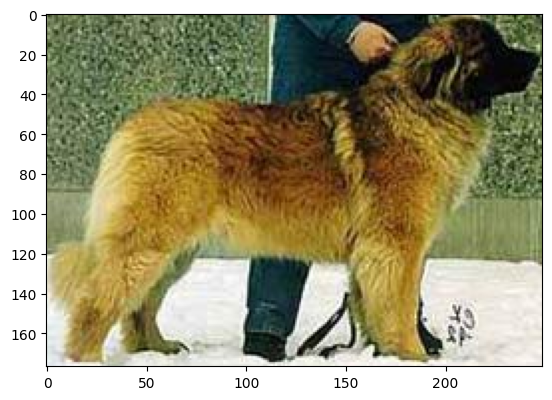

French_bulldog


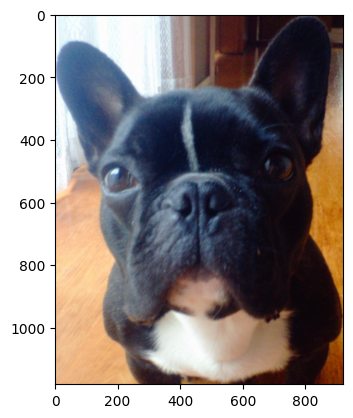

Border_terrier


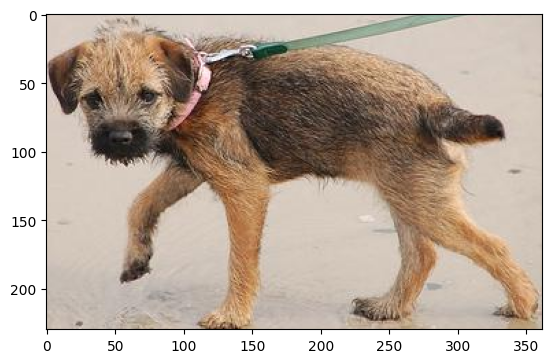

Weimaraner


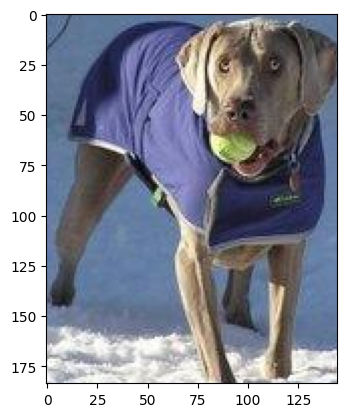

Samoyed


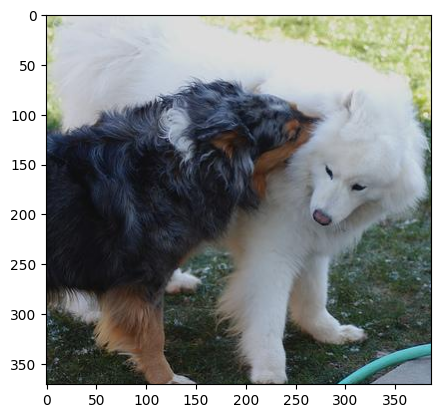

Brabancon_griffon


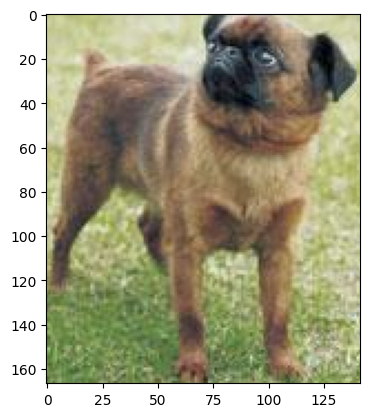

Shetland_sheepdog


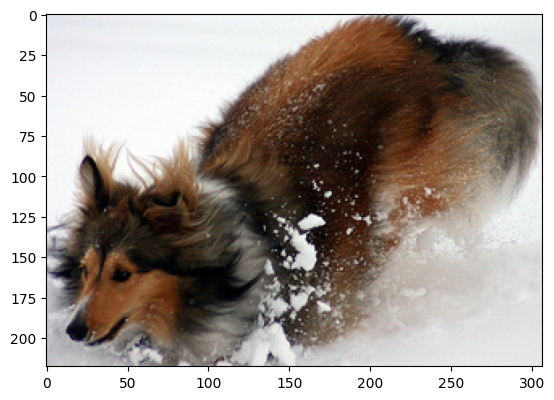

collie


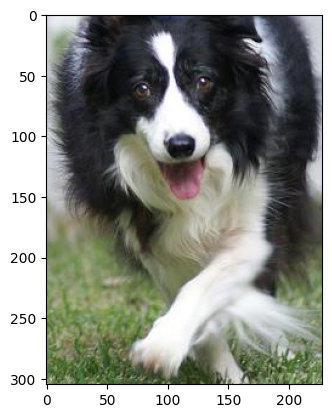

Doberman


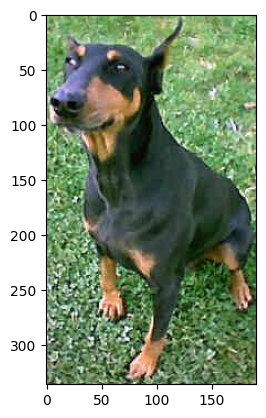

African_hunting_dog


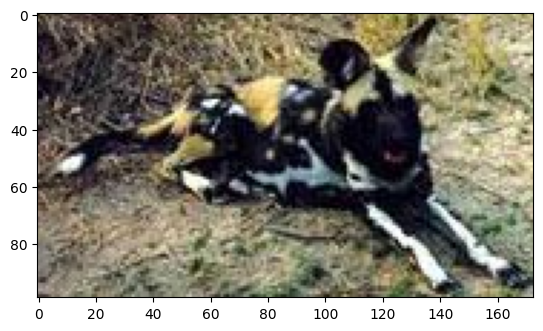

Brittany_spaniel


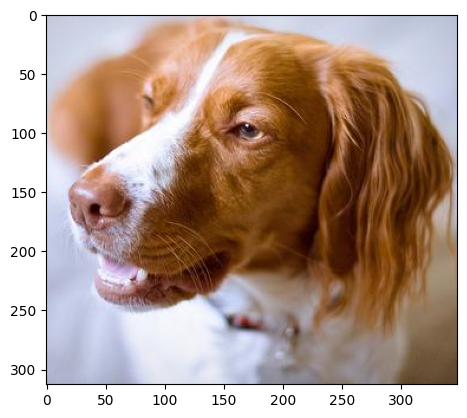

Chihuahua


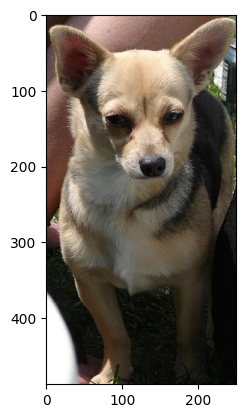

Siberian_husky


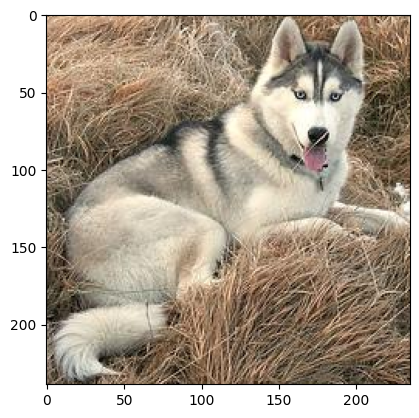

standard_schnauzer


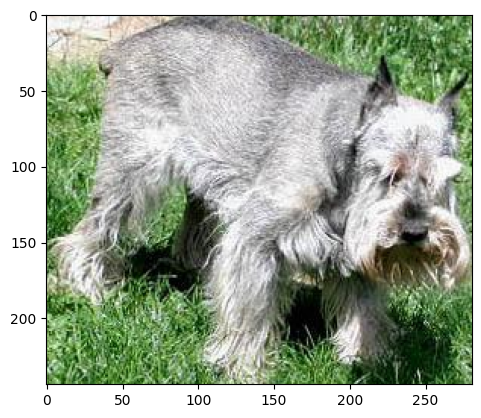

Pomeranian


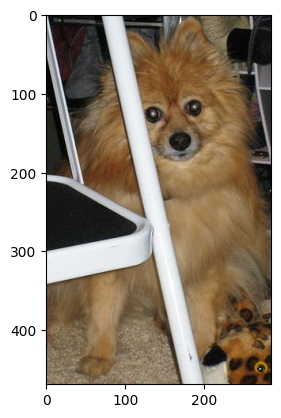

bluetick


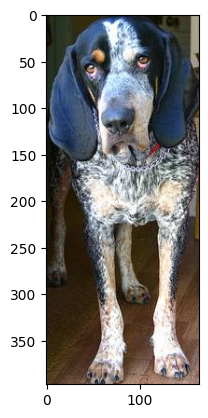

German_shepherd


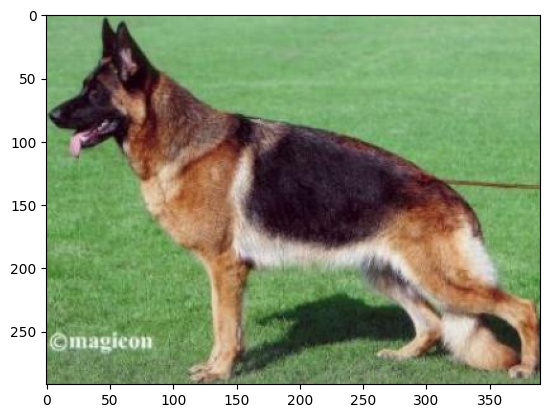

cairn


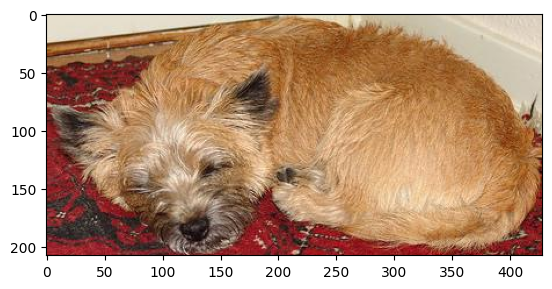

Norwegian_elkhound


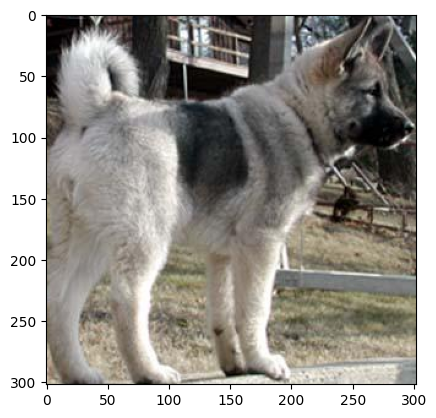

papillon


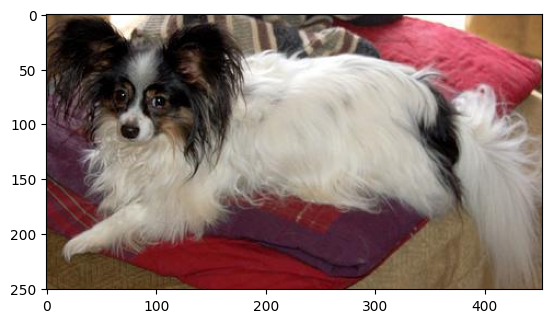

standard_poodle


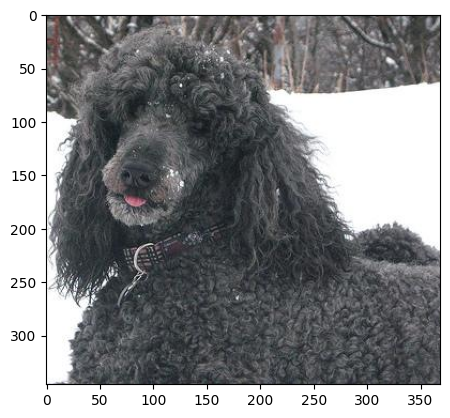

Maltese_dog


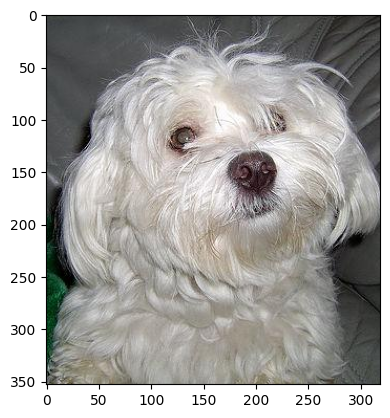

otterhound


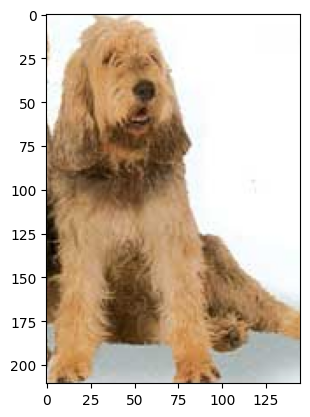

chow


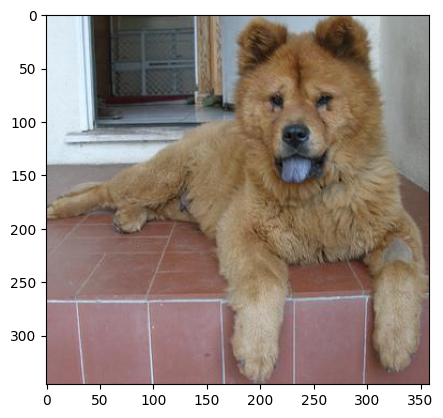

dingo


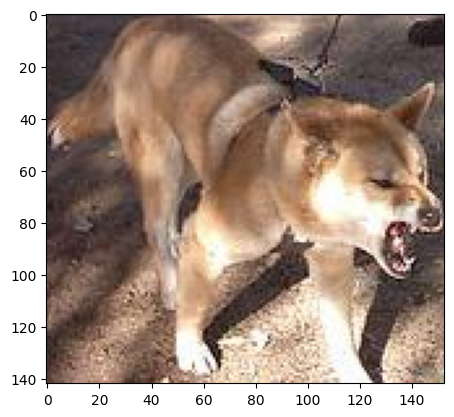

soft-coated_wheaten_terrier


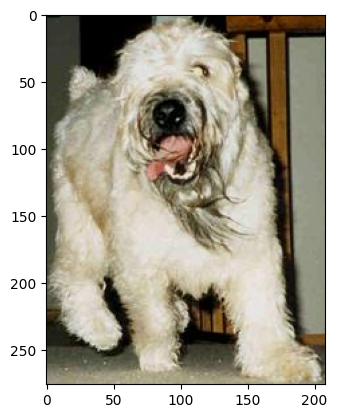

Ibizan_hound


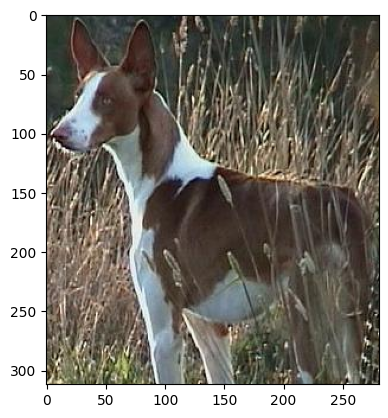

Sealyham_terrier


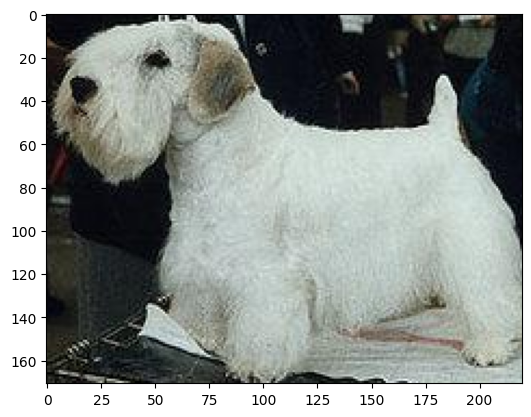

dhole


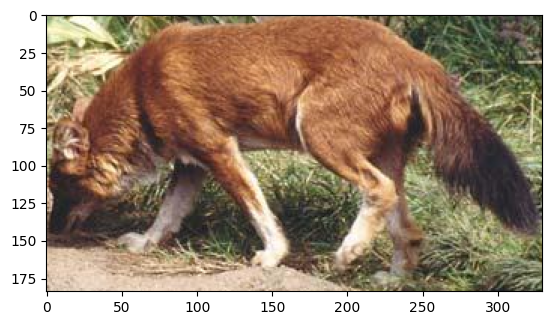

Greater_Swiss_Mountain_dog


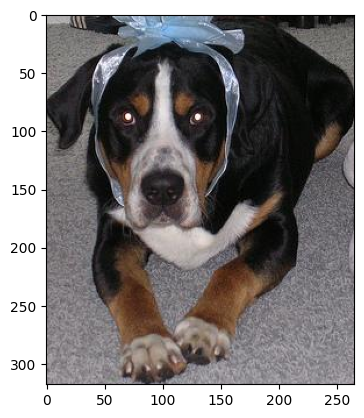

basenji


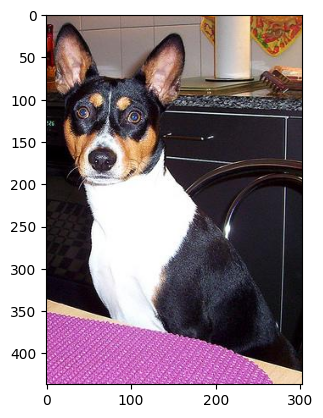

Tibetan_terrier


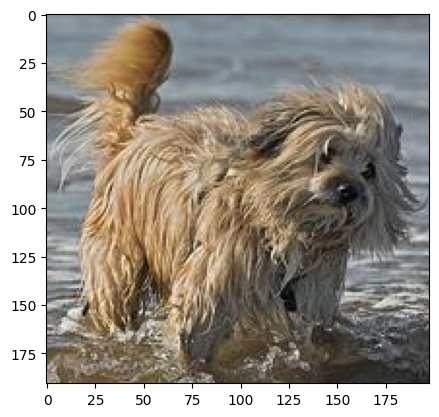

West_Highland_white_terrier


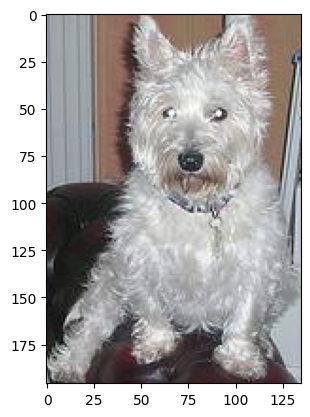

boxer


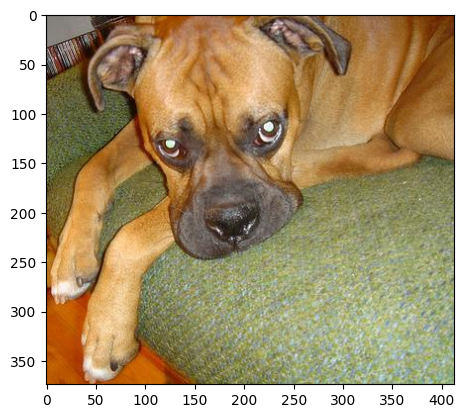

toy_poodle


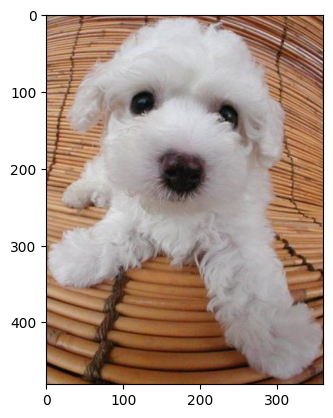

Irish_setter


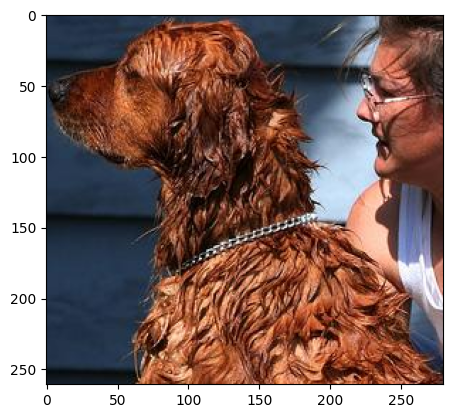

Saluki


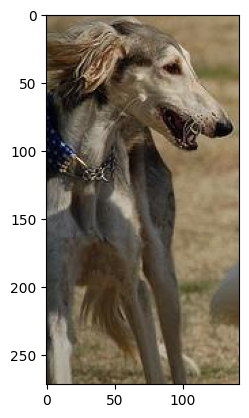

Italian_greyhound


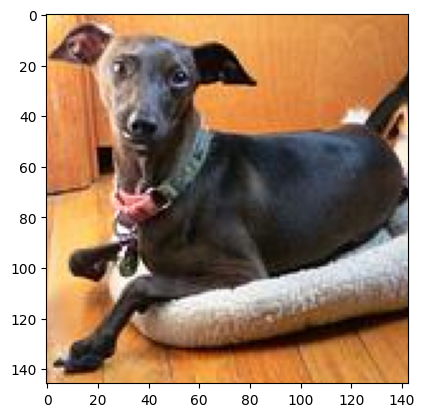

malinois


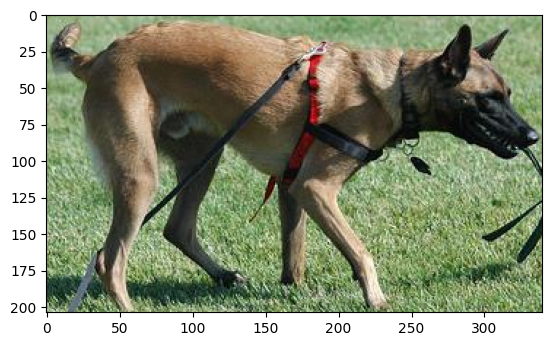

Irish_terrier


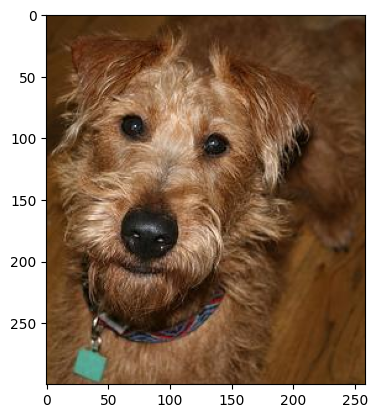

redbone


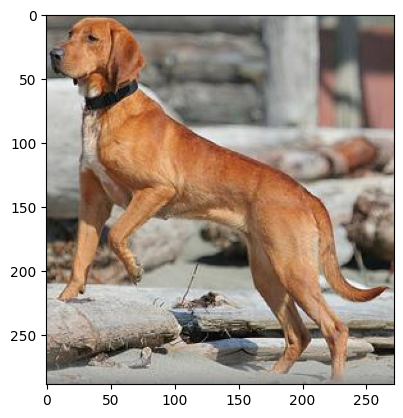

Pekinese


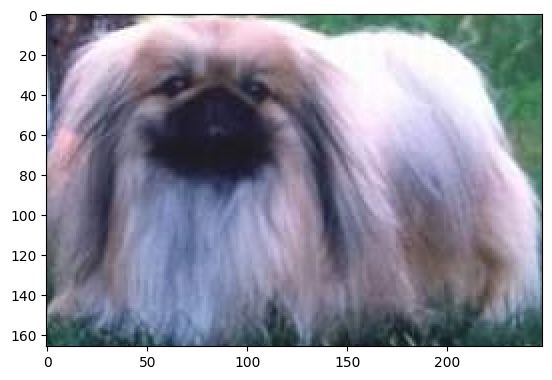

clumber


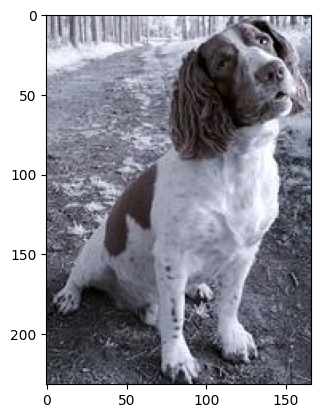

kelpie


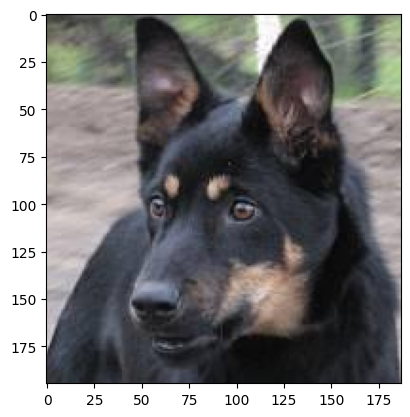

Sussex_spaniel


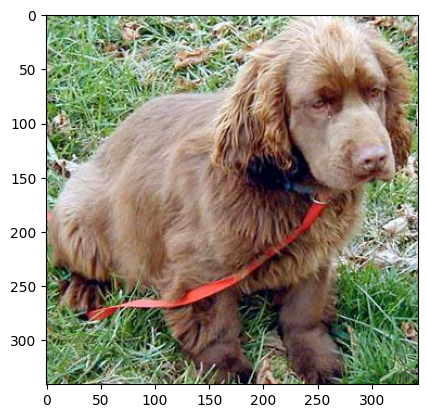

golden_retriever


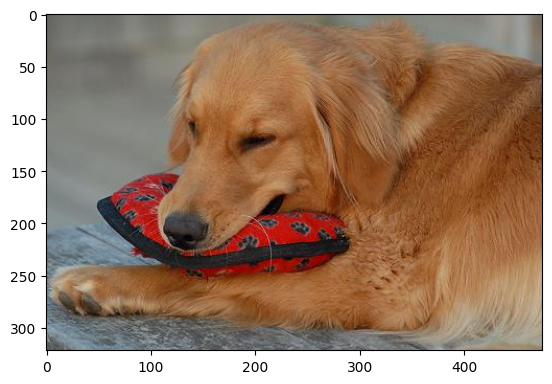

Labrador_retriever


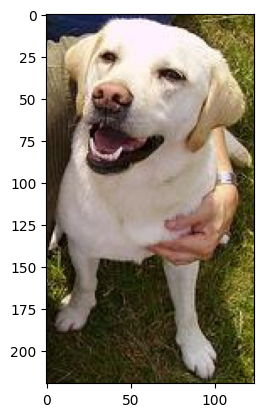

groenendael


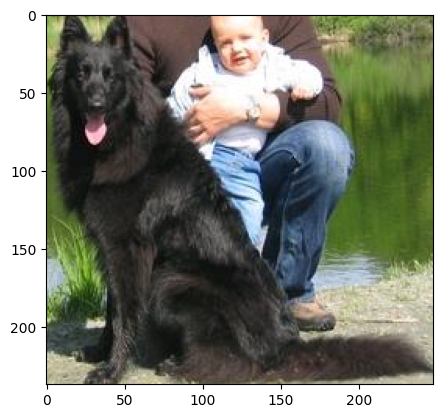

Scotch_terrier


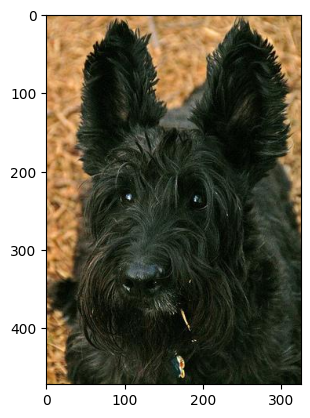

Newfoundland


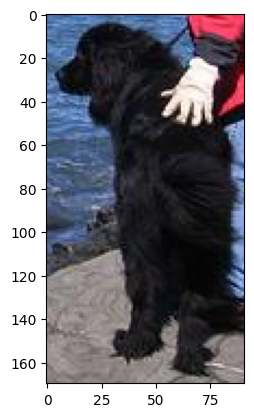

Lhasa


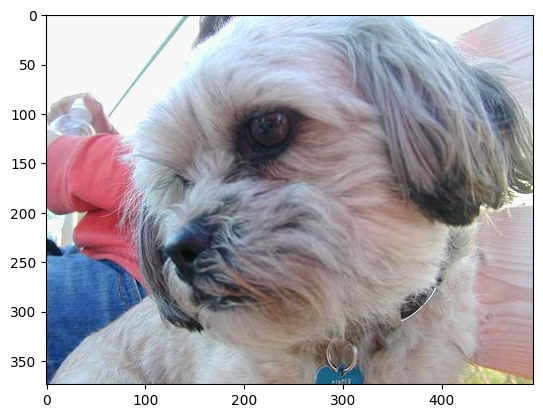

Shih-Tzu


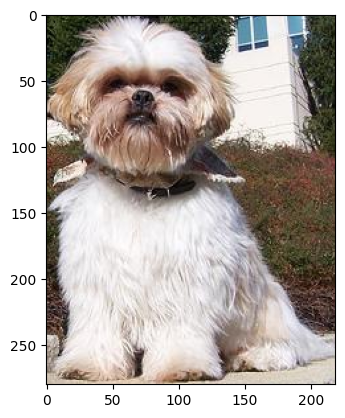

Irish_water_spaniel


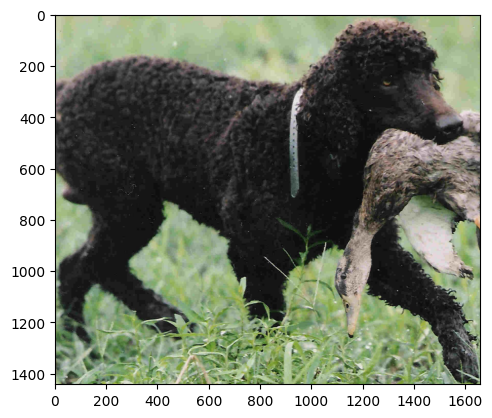

Blenheim_spaniel


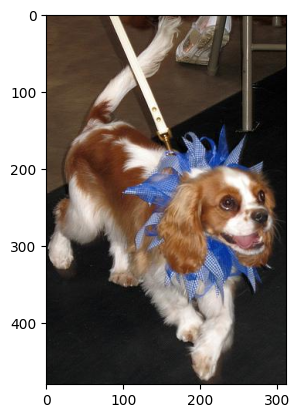

Dandie_Dinmont


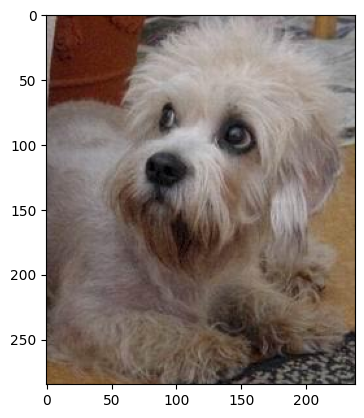

Yorkshire_terrier


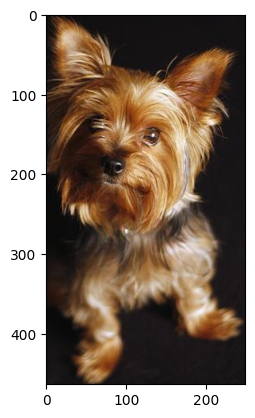

basset


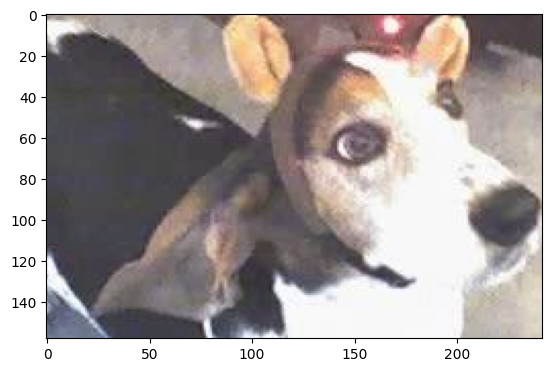

pug


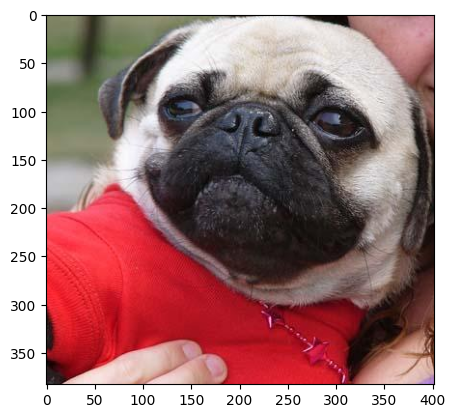

Tibetan_mastiff


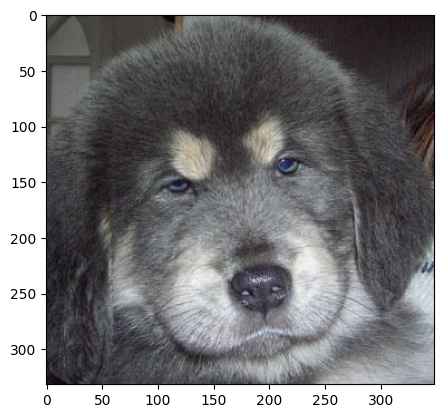

keeshond


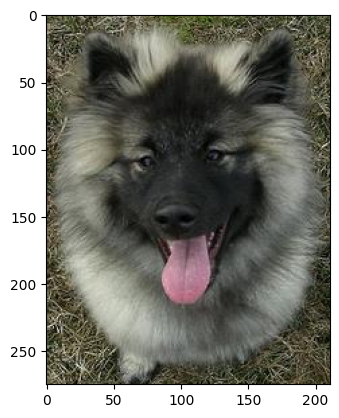

Border_collie


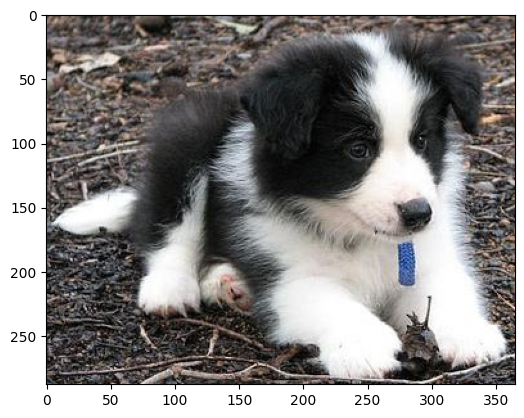

vizsla


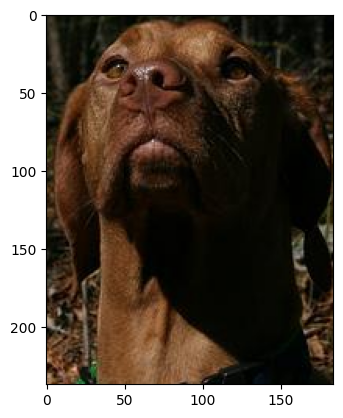

Rhodesian_ridgeback


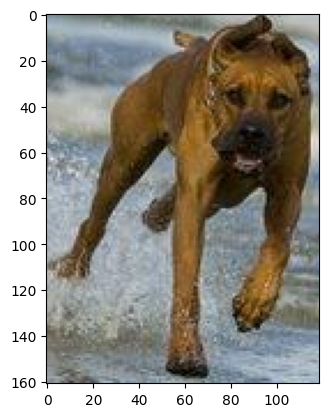

Irish_wolfhound


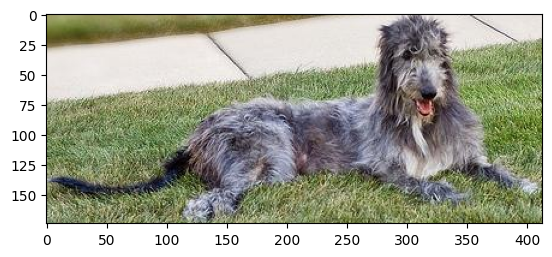

silky_terrier


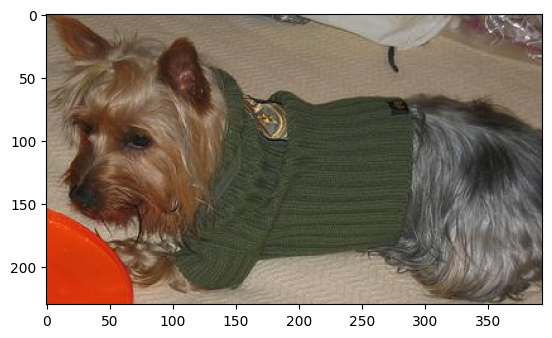

Gordon_setter


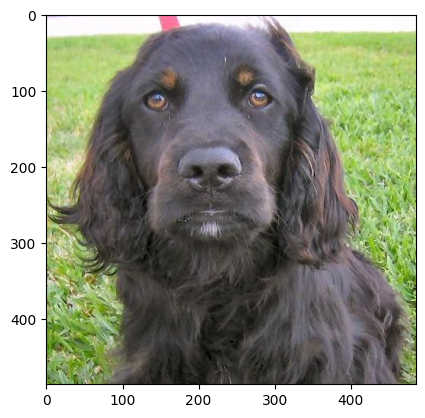

malamute


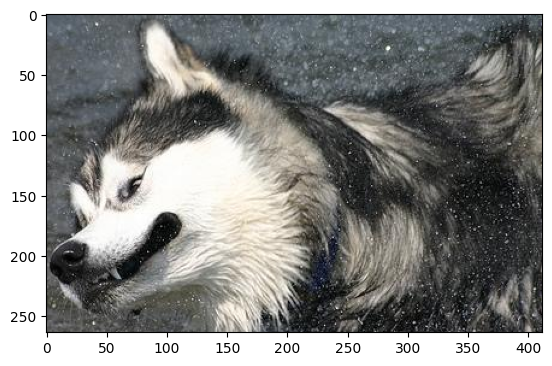

Boston_bull


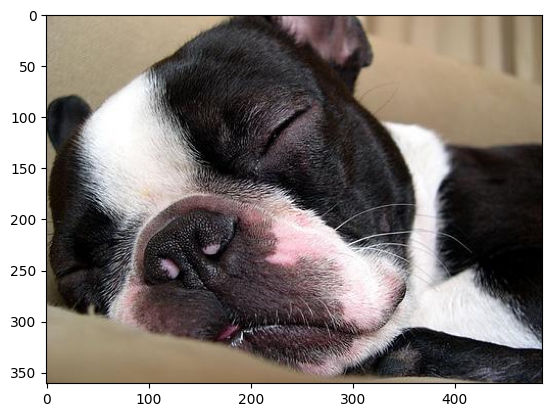

whippet


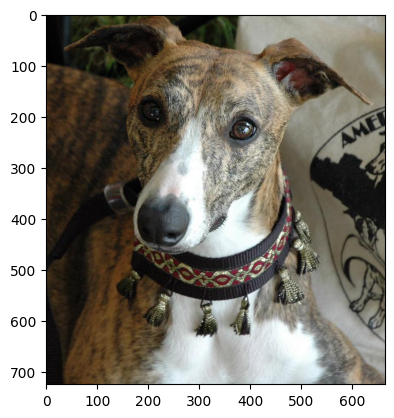

Mexican_hairless


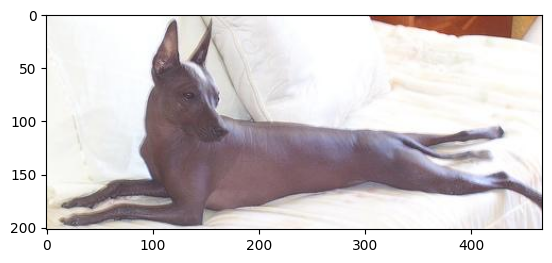

curly-coated_retriever


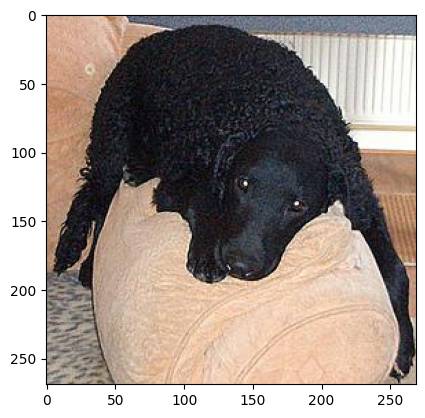

Afghan_hound


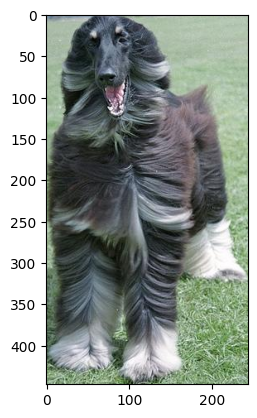

English_springer


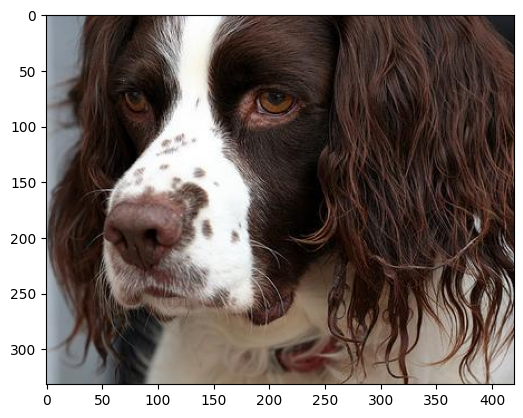

Walker_hound


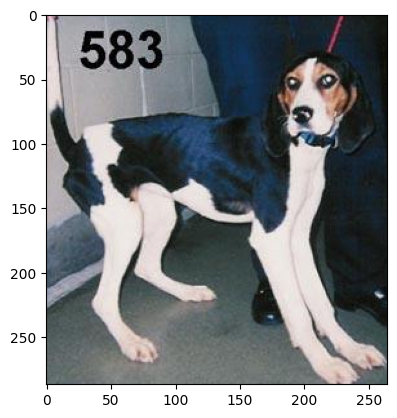

wire-haired_fox_terrier


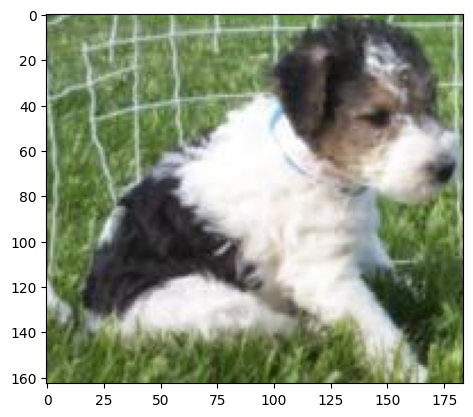

miniature_pinscher


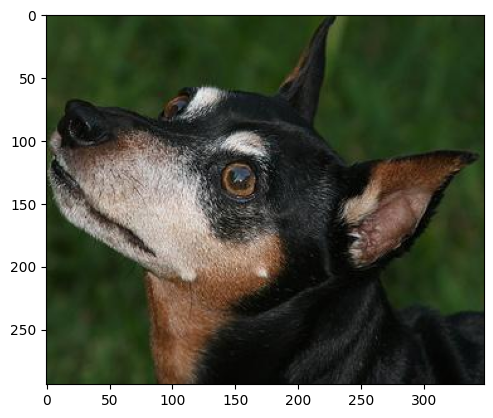

Saint_Bernard


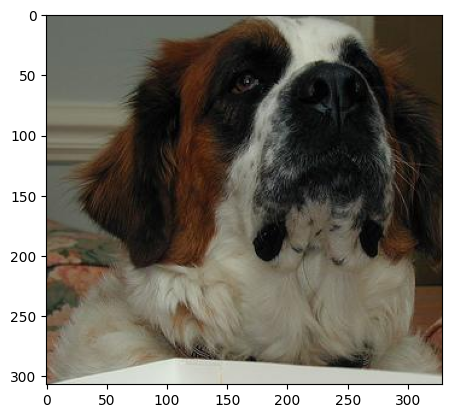

kuvasz


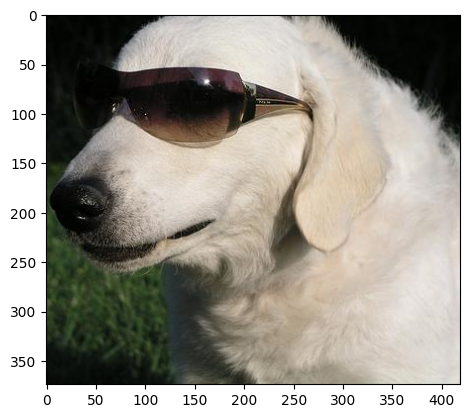

Chesapeake_Bay_retriever


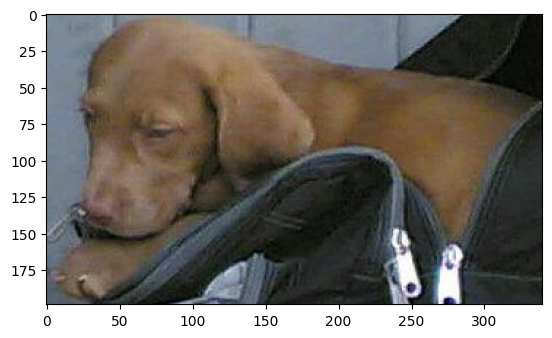

Australian_terrier


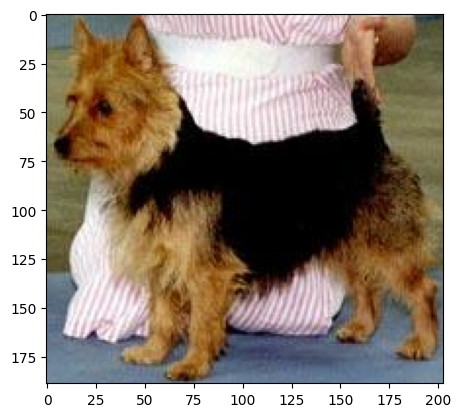

Airedale


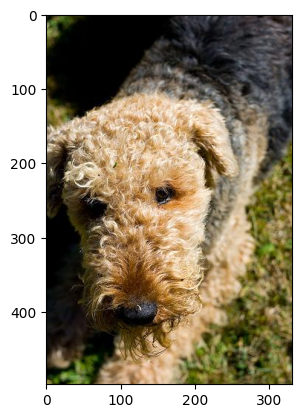

borzoi


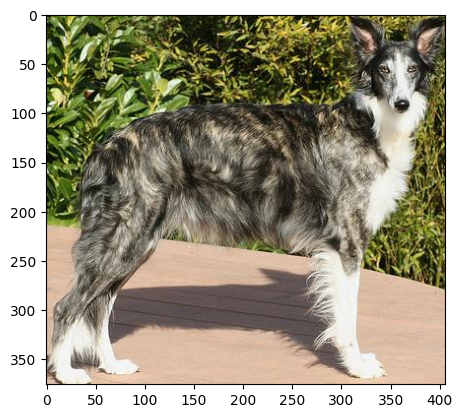

Pembroke


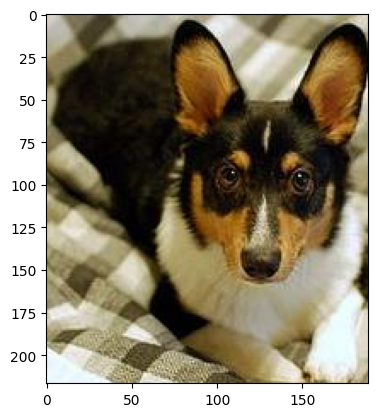

bloodhound


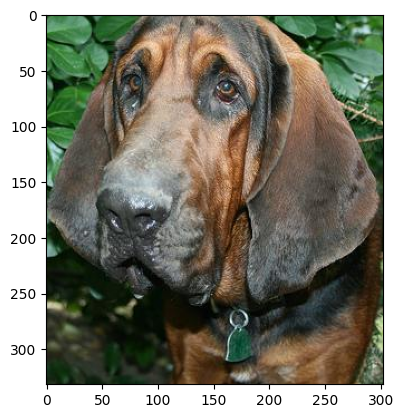

briard


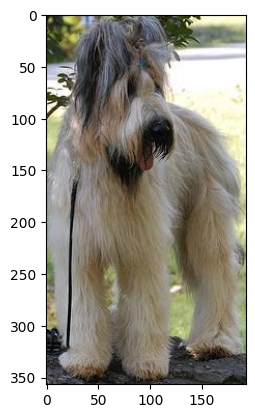

Staffordshire_bullterrier


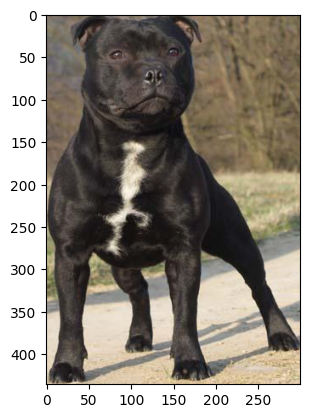

giant_schnauzer


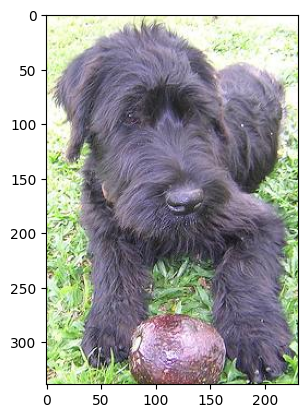

toy_terrier


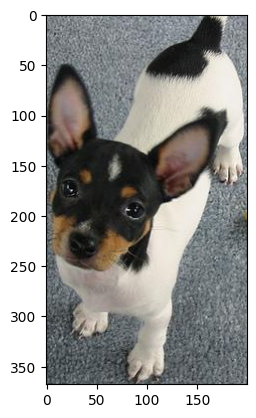

English_foxhound


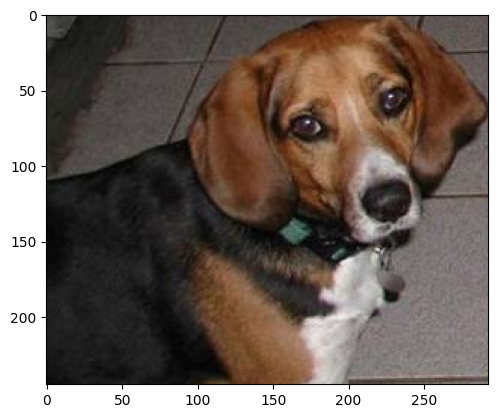

black-and-tan_coonhound


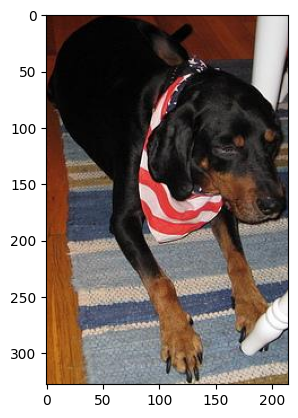

Great_Pyrenees


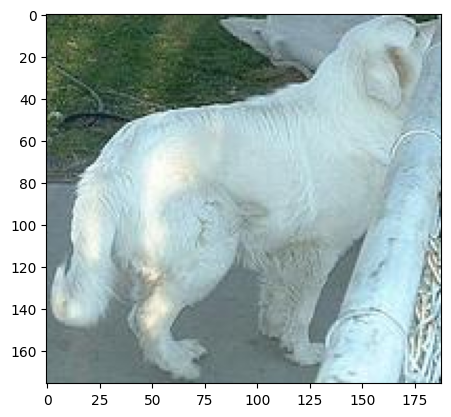

Rottweiler


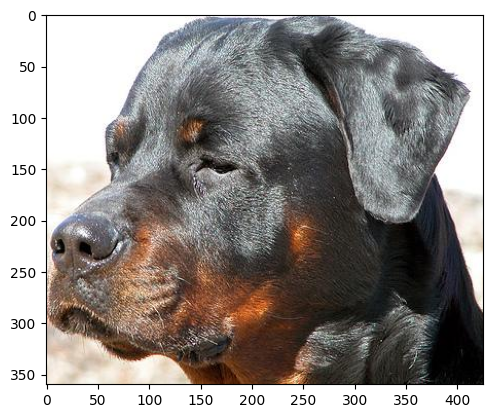

Lakeland_terrier


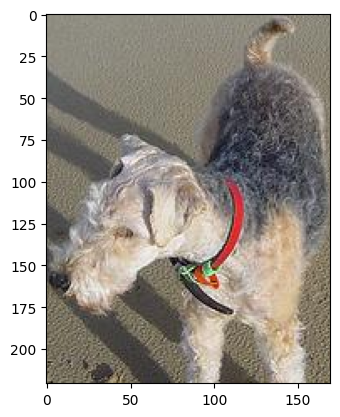

EntleBucher


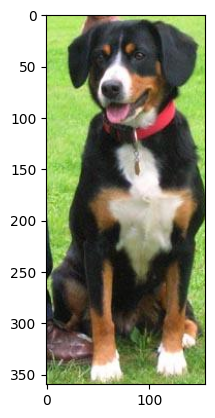

Bedlington_terrier


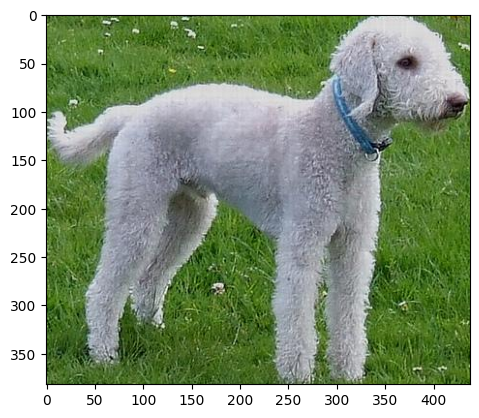

Bouvier_des_Flandres


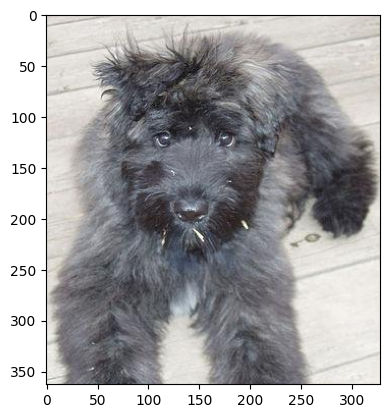

Kerry_blue_terrier


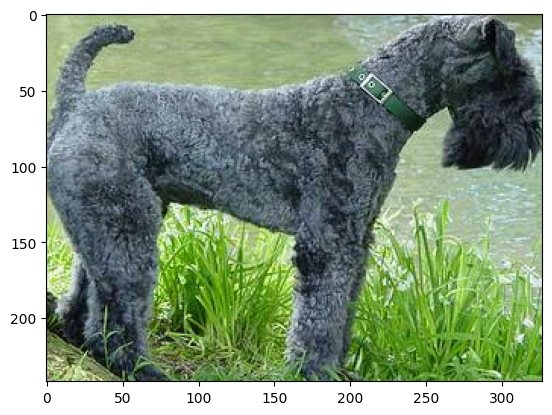

komondor


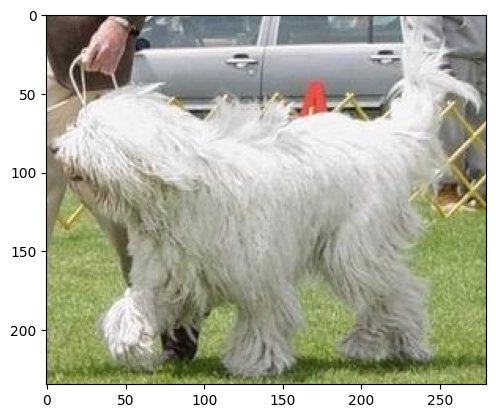

flat-coated_retriever


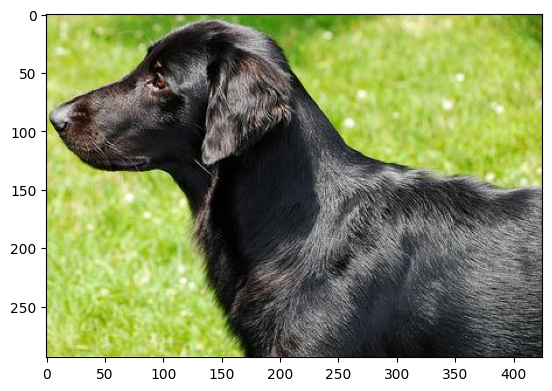

cocker_spaniel


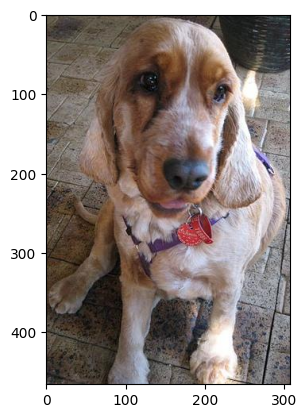

Eskimo_dog


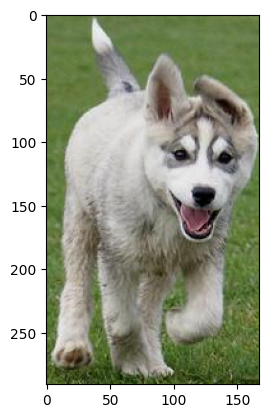

Cardigan


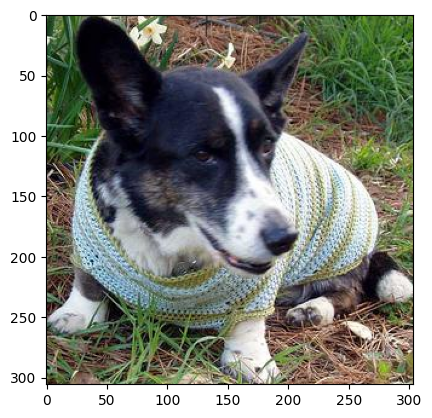

American_Staffordshire_terrier


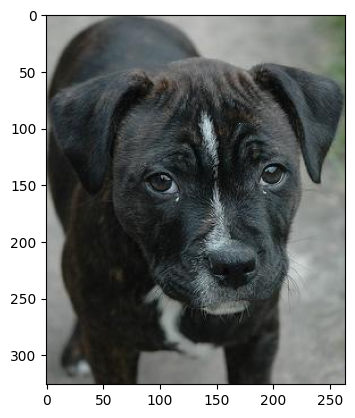

affenpinscher


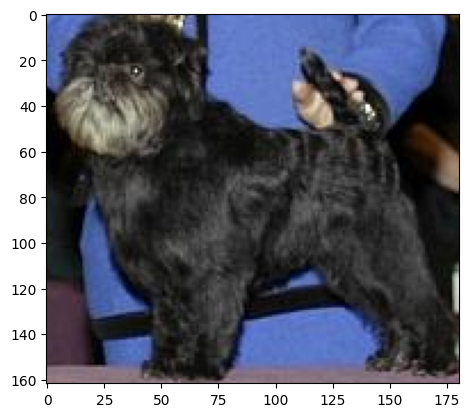

beagle


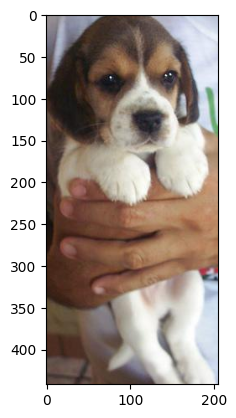

Norwich_terrier


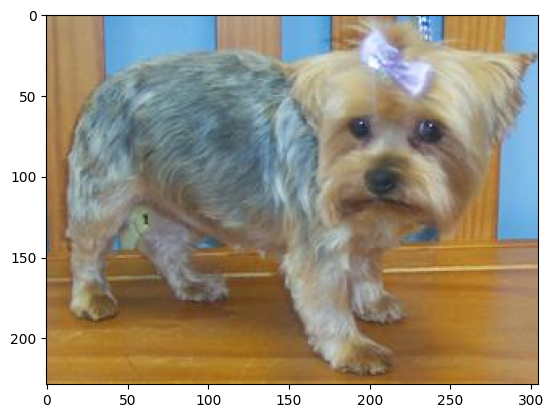

Norfolk_terrier


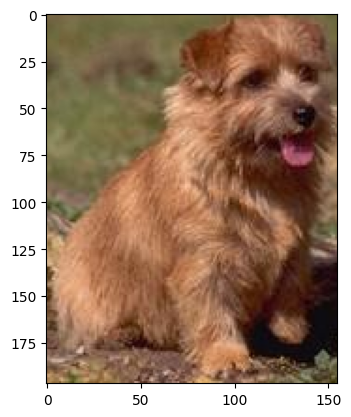

Old_English_sheepdog


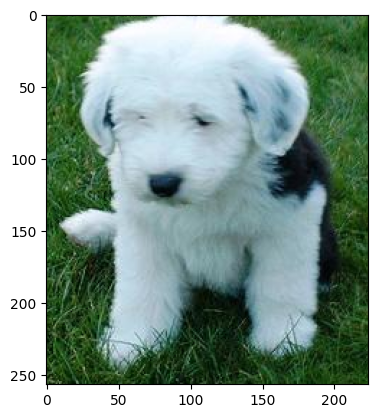

In [38]:
readImageAndAnnotationFiles(root_data_dir, data_dir, annotation_dir)

In [39]:
test_data_dir = root_data_dir / 'AllImages'
for child in test_data_dir.iterdir():
  print(child.name)

Dandie_Dinmont
otterhound
golden_retriever
malamute
dhole
Norfolk_terrier
black-and-tan_coonhound
whippet
Pembroke
curly-coated_retriever
standard_schnauzer
collie
clumber
Irish_water_spaniel
Leonberg
Bouvier_des_Flandres
Newfoundland
giant_schnauzer
Brabancon_griffon
standard_poodle
Ibizan_hound
bull_mastiff
Norwegian_elkhound
Tibetan_terrier
Pekinese
affenpinscher
Irish_setter
schipperke
Greater_Swiss_Mountain_dog
groenendael
cairn
Border_collie
Sealyham_terrier
Irish_wolfhound
kuvasz
Lhasa
Japanese_spaniel
Great_Pyrenees
Staffordshire_bullterrier
Tibetan_mastiff
briard
Welsh_springer_spaniel
Samoyed
West_Highland_white_terrier
Shih-Tzu
toy_terrier
pug
English_foxhound
Boston_bull
kelpie
Gordon_setter
komondor
basenji
bloodhound
Scottish_deerhound
Australian_terrier
German_shepherd
Chihuahua
dingo
bluetick
Shetland_sheepdog
Chesapeake_Bay_retriever
Irish_terrier
Eskimo_dog
miniature_poodle
EntleBucher
English_setter
flat-coated_retriever
wire-haired_fox_terrier
Blenheim_spaniel
Susse

In [41]:
one_test_data = test_data_dir / 'golden_retriever'
for child in one_test_data.iterdir():
  print(child.name)

image_104.png
image_147.png
image_107.png
image_47.png
image_124.png
image_75.png
image_119.png
image_79.png
image_51.png
image_149.png
image_67.png
image_128.png
image_45.png
image_16.png
image_14.png
image_21.png
image_117.png
image_142.png
image_12.png
image_137.png
image_73.png
image_111.png
image_88.png
image_65.png
image_13.png
image_127.png
image_129.png
image_34.png
image_26.png
image_25.png
image_66.png
image_96.png
image_141.png
image_116.png
image_112.png
image_101.png
image_121.png
image_35.png
image_136.png
image_28.png
image_9.png
image_41.png
image_71.png
image_115.png
image_1.png
image_133.png
image_76.png
image_118.png
image_83.png
image_146.png
image_11.png
image_122.png
image_86.png
image_114.png
image_131.png
image_22.png
image_126.png
image_74.png
image_94.png
image_143.png
image_6.png
image_59.png
image_80.png
image_55.png
image_27.png
image_18.png
image_4.png
image_46.png
image_106.png
image_32.png
image_43.png
image_15.png
image_49.png
image_140.png
image_23.png

## Create datasets
  

In [42]:
batch_size = 32
img_height = 180
img_width = 180

Train 80%, Test 20%


In [43]:
train_ds = tf.keras.utils.image_dataset_from_directory(
  test_data_dir,
  validation_split=0.2,
  subset="training",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 20580 files belonging to 120 classes.
Using 16464 files for training.


In [44]:
val_ds = tf.keras.utils.image_dataset_from_directory(
  test_data_dir,
  validation_split=0.2,
  subset="validation",
  seed=123,
  image_size=(img_height, img_width),
  batch_size=batch_size)

Found 20580 files belonging to 120 classes.
Using 4116 files for validation.


In [45]:
class_names = train_ds.class_names
print(class_names)

['Afghan_hound', 'African_hunting_dog', 'Airedale', 'American_Staffordshire_terrier', 'Appenzeller', 'Australian_terrier', 'Bedlington_terrier', 'Bernese_mountain_dog', 'Blenheim_spaniel', 'Border_collie', 'Border_terrier', 'Boston_bull', 'Bouvier_des_Flandres', 'Brabancon_griffon', 'Brittany_spaniel', 'Cardigan', 'Chesapeake_Bay_retriever', 'Chihuahua', 'Dandie_Dinmont', 'Doberman', 'English_foxhound', 'English_setter', 'English_springer', 'EntleBucher', 'Eskimo_dog', 'French_bulldog', 'German_shepherd', 'German_short-haired_pointer', 'Gordon_setter', 'Great_Dane', 'Great_Pyrenees', 'Greater_Swiss_Mountain_dog', 'Ibizan_hound', 'Irish_setter', 'Irish_terrier', 'Irish_water_spaniel', 'Irish_wolfhound', 'Italian_greyhound', 'Japanese_spaniel', 'Kerry_blue_terrier', 'Labrador_retriever', 'Lakeland_terrier', 'Leonberg', 'Lhasa', 'Maltese_dog', 'Mexican_hairless', 'Newfoundland', 'Norfolk_terrier', 'Norwegian_elkhound', 'Norwich_terrier', 'Old_English_sheepdog', 'Pekinese', 'Pembroke', 'Po

## データを視覚化する

以下はトレーニングデータセットの最初の 9 枚の画像です。

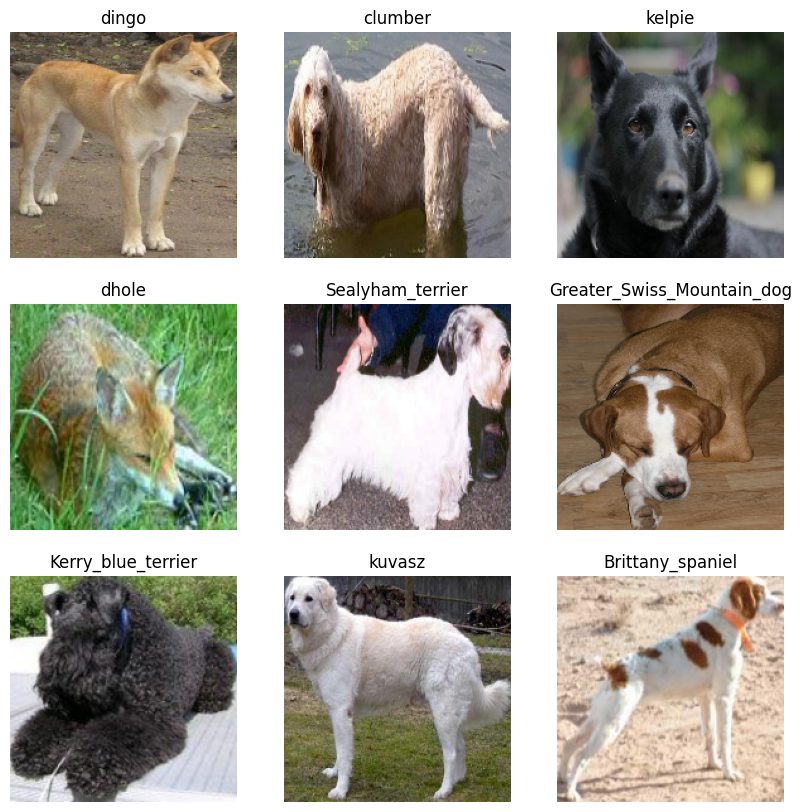

In [46]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

これらのデータセットを Keras `Model.fit` に渡すことで、モデルをトレーニングできます（このチュートリアルの後の方で説明しています）。また、手動でデータセットを反復し、画像のバッチを取得することもできます。

In [47]:
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)
  break

(32, 180, 180, 3)
(32,)


`image_batch`は、形状`(32, 180, 180, 3)`のテンソルです。これは、形状`180x180x3`の 32 枚の画像のバッチです（最後の次元はカラーチャンネル RGB を参照します）。`label_batch`は、形状`(32,)`のテンソルであり、これらは 32 枚の画像に対応するラベルです。

`image_batch`および`labels_batch`テンソルで`.numpy()`を呼び出して、それらを`numpy.ndarray`に変換できます。


## データセットを構成してパフォーマンスを改善する

I/O がブロックされることなくディスクからデータを取得できるように、必ずバッファ付きプリフェッチを使用します。これらは、データを読み込むときに使用する必要がある 2 つの重要な方法です。

- `Dataset.cache()`は、最初のエポック中に画像をディスクから読み込んだ後、メモリに保持します。これにより、モデルのトレーニング中にデータセットがボトルネックになることを回避できます。データセットが大きすぎてメモリに収まらない場合は、この方法を使用して、パフォーマンスの高いオンディスクキャッシュを作成することもできます。
- `Dataset.prefetch` はトレーニング中にデータの前処理とモデルの実行をオーバーラップさせます。

以上の 2 つの方法とデータをディスクにキャッシュする方法についての詳細は、<a>データパフォーマンスガイド</a>の <em>プリフェッチ</em>を参照してください。

In [48]:
AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.cache().shuffle(1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch(buffer_size=AUTOTUNE)

## データを標準化する

RGB チャネル値は `[0, 255]` の範囲にあり、ニューラルネットワークには理想的ではありません。一般に、入力値は小さくする必要があります。

ここでは、`tf.keras.layers.Rescaling` を使用して、値を `[0, 1]` の範囲に標準化します。

In [49]:
normalization_layer = layers.Rescaling(1./255)

このレイヤーを使用するには 2 つの方法があります。`Dataset.map` を呼び出すことにより、データセットに適用できます。

In [50]:
normalized_ds = train_ds.map(lambda x, y: (normalization_layer(x), y))
image_batch, labels_batch = next(iter(normalized_ds))
first_image = image_batch[0]
# Notice the pixel values are now in `[0,1]`.
print(np.min(first_image), np.max(first_image))

0.0 1.0


または、モデル定義内にレイヤーを含めることができます。これにより、デプロイメントを簡素化できます。 ここでは 2 番目のアプローチを使用します。

注意: 以前は、`tf.keras.utils.image_dataset_from_directory` の `image_size` 引数を使用して画像のサイズを変更しました。モデルにサイズ変更ロジックも含める場合は、`tf.keras.layers.Resizing` レイヤーを使用できます。

## 基本的な Keras モデル

### モデルを作成する

[Sequential](https://www.tensorflow.org/guide/keras/sequential_model) モデルは、それぞれに最大プールレイヤー （`tf.keras.layers.MaxPooling2D`）を持つ 3 つの畳み込みブロック（`tf.keras.layers.Conv2D`）で構成されます。ReLU 活性化関数（`'relu'`）により活性化されたユニットが 128 個ある完全に接続されたレイヤー （`tf.keras.layers.Dense`）があります。このチュートリアルの目的は、標準的なアプローチを示すことなので、このモデルは高精度に調整されていません。

In [51]:
num_classes = len(class_names)

model = Sequential([
  layers.Rescaling(1./255, input_shape=(img_height, img_width, 3)),
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes)
])

/usr/local/lib/python3.11/dist-packages/keras/src/layers/preprocessing/tf_data_layer.py:19: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


### モデルをコンパイルする

このチュートリアルでは、`tf.keras.optimizers.Adam` オプティマイザと`tf.keras.losses.SparseCategoricalCrossentropy` 損失関数を選択します。各トレーニングエポックのトレーニングと検証の精度を表示するには、`Model.compile` に `metrics` 引数を渡します。

In [52]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

### モデルの概要

Keras の `Model.summary` メソッドを使用して、ネットワークのすべてのレイヤーを表示します。

In [53]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ rescaling_1 (Rescaling)              │ (None, 180, 180, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 180, 180, 16)        │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 90, 90, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 90, 90, 32)          │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 45, 45, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 45, 45, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 22, 22, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 30976)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │       3,965,056 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 120)                 │          15,480 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 4,004,120 (15.27 MB)

 Trainable params: 4,004,120 (15.27 MB)

 Non-trainable params: 0 (0.00 B)

### モデルをトレーニングする

Keras `Model.fit` メソッドを使用して、10 エポックのモデルをトレーニングします。

In [54]:
epochs=10
history = model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/10
515/515 ━━━━━━━━━━━━━━━━━━━━ 33s 53ms/step - accuracy: 0.0176 - loss: 4.6893 - val_accuracy: 0.0559 - val_loss: 4.2298
Epoch 2/10
515/515 ━━━━━━━━━━━━━━━━━━━━ 9s 17ms/step - accuracy: 0.0842 - loss: 4.0456 - val_accuracy: 0.0960 - val_loss: 3.9499
Epoch 3/10
515/515 ━━━━━━━━━━━━━━━━━━━━ 11s 18ms/step - accuracy: 0.1703 - loss: 3.4627 - val_accuracy: 0.1113 - val_loss: 3.8777
Epoch 4/10
515/515 ━━━━━━━━━━━━━━━━━━━━ 9s 17ms/step - accuracy: 0.3072 - loss: 2.7776 - val_accuracy: 0.1178 - val_loss: 4.0626
Epoch 5/10
515/515 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - accuracy: 0.5036 - loss: 1.8976 - val_accuracy: 0.1105 - val_loss: 4.6662
Epoch 6/10
515/515 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - accuracy: 0.7222 - loss: 1.0509 - val_accuracy: 0.1057 - val_loss: 6.0106
Epoch 7/10
515/515 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - accuracy: 0.8594 - loss: 0.5230 - val_accuracy: 0.0950 - val_loss: 7.9044
Epoch 8/10
515/515 ━━━━━━━━━━━━━━━━━━━━ 10s 17ms/step - accuracy: 0.9334 - loss: 0.2508 - va

## トレーニングの結果を視覚化する

トレーニングセットと検証セットで損失と精度のプロットを作成します。

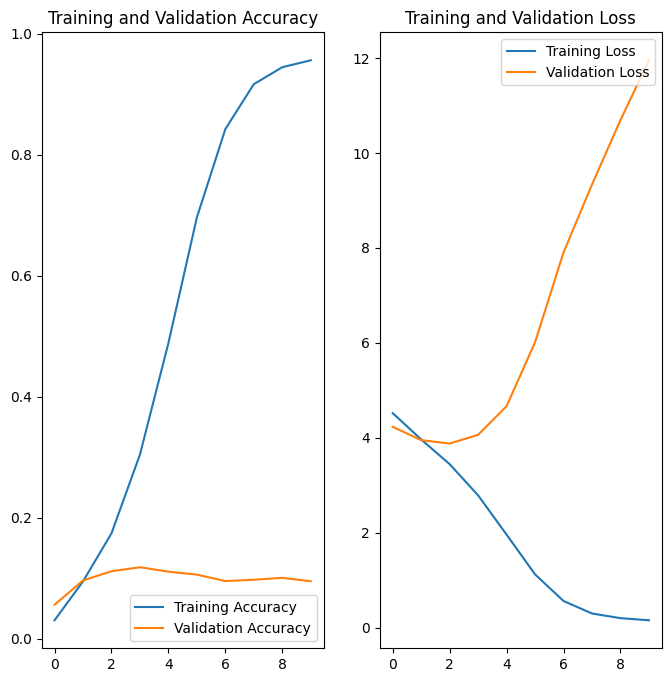

In [55]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

プロットには、トレーニングの精度と検証の精度は大幅にずれており、モデルは検証セットで約 60％ の精度しか達成していないことが示されています。

以下のチュートリアルセクションでは、問題の原因を調べ、モデルの全体的なパフォーマンスを向上させる方法を示します。

## 過学習

上記のプロットでは、トレーニングの精度は時間の経過とともに直線的に増加していますが、検証の精度はトレーニングプロセスで約60％のままです。また、トレーニングと検証の精度に大きな違いがあり、これは[過学習](https://www.tensorflow.org/tutorials/keras/overfit_and_underfit)の兆候を示しています。

トレーニングサンプルの数が少ない場合、モデルは、トレーニングサンプルのノイズや不要な詳細から学習し、新しいサンプルでのモデルのパフォーマンスに悪影響を及ぼすことがあります。 この現象は過学習として知られています。 これは、モデルが新しいデータセットで一般化する上で問題があることを意味します。

トレーニングプロセスで過学習を回避する方法は複数あります。このチュートリアルでは、*データ拡張*を使用して、モデルに*ドロップアウト*を追加します。

## データ拡張

過学習は、一般に、トレーニングサンプルの数が少ない場合に発生します。[データ拡張](./data_augmentation.ipynb)は、既存のサンプルに対してランダムな変換を使用してサンプルを拡張することにより、追加のトレーニングデータを生成します。これにより、モデルをデータのより多くの側面でトレーニングし、より一般化することができます。

`tf.keras.layers.RandomFlip`、`tf.keras.layers.RandomRotation`、および `tf.keras.layers.RandomZoom` の前処理レイヤーを使用して、データ拡張を実装します。これらは、他のレイヤーと同様にモデル内に含めて、GPU で実行できます。

In [56]:
data_augmentation = keras.Sequential(
  [
    layers.RandomFlip("horizontal",
                      input_shape=(img_height,
                                  img_width,
                                  3)),
    layers.RandomRotation(0.1),
    layers.RandomZoom(0.1),
  ]
)

同じ画像にデータ拡張を数回適用して、いくつかの拡張されたデータがどのようになるかを視覚化してみましょう。

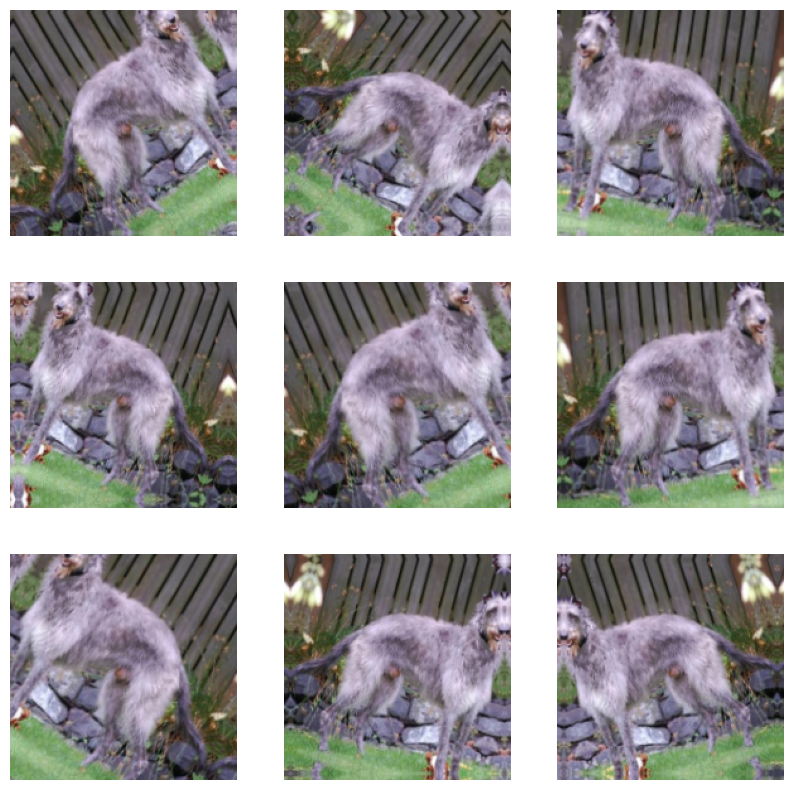

In [57]:
plt.figure(figsize=(10, 10))
for images, _ in train_ds.take(1):
  for i in range(9):
    augmented_images = data_augmentation(images)
    ax = plt.subplot(3, 3, i + 1)
    plt.imshow(augmented_images[0].numpy().astype("uint8"))
    plt.axis("off")

次のステップでトレーニングする前に、モデルにデータ拡張を追加します。

## ドロップアウト

過学習を回避するもう 1 つの方法は、[ドロップアウト](https://developers.google.com/machine-learning/glossary#dropout_regularization){:.external} 正則化をネットワークに導入することです。

ドロップアウトをレイヤーに適用すると、トレーニングプロセス中にレイヤーからいくつかの出力ユニットがランダムにドロップアウトされます（アクティベーションをゼロに設定することにより）。ドロップアウトは、0.1、0.2、0.4 などの形式で、入力値として小数を取ります。これは、適用されたレイヤーから出力ユニットの 10％、20％、または 40％ をランダムにドロップアウトすることを意味します。

拡張された画像を使用してトレーニングする前に、`tf.keras.layers.Dropout` を使用して新しいニューラルネットワークを作成します。

In [58]:
num_classes = len(class_names)

model = Sequential([
  data_augmentation,
  layers.Rescaling(1./255),
  layers.Conv2D(16, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(32, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Conv2D(64, 3, padding='same', activation='relu'),
  layers.MaxPooling2D(),
  layers.Dropout(0.2),
  layers.Flatten(),
  layers.Dense(128, activation='relu'),
  layers.Dense(num_classes, name="outputs")
])

## モデルをコンパイルしてトレーニングする

In [59]:
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [60]:
model.summary()

Model: "sequential_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ sequential_1 (Sequential)            │ (None, 180, 180, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ rescaling_2 (Rescaling)              │ (None, 180, 180, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_3 (Conv2D)                    │ (None, 180, 180, 16)        │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_3 (MaxPooling2D)       │ (None, 90, 90, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_4 (Conv2D)                    │ (None, 90, 90, 32)          │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_4 (MaxPooling2D)       │ (None, 45, 45, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_5 (Conv2D)                    │ (None, 45, 45, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_5 (MaxPooling2D)       │ (None, 22, 22, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 22, 22, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten_1 (Flatten)                  │ (None, 30976)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_2 (Dense)                      │ (None, 128)                 │       3,965,056 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ outputs (Dense)                      │ (None, 120)                 │          15,480 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 4,004,120 (15.27 MB)

 Trainable params: 4,004,120 (15.27 MB)

 Non-trainable params: 0 (0.00 B)

In [61]:
epochs = 15
history = model.fit(
  train_ds,
  validation_data=val_ds,
  epochs=epochs
)

Epoch 1/15
515/515 ━━━━━━━━━━━━━━━━━━━━ 18s 28ms/step - accuracy: 0.0187 - loss: 4.6869 - val_accuracy: 0.0491 - val_loss: 4.2479
Epoch 2/15
515/515 ━━━━━━━━━━━━━━━━━━━━ 19s 27ms/step - accuracy: 0.0548 - loss: 4.1854 - val_accuracy: 0.0719 - val_loss: 4.0468
Epoch 3/15
515/515 ━━━━━━━━━━━━━━━━━━━━ 14s 28ms/step - accuracy: 0.0882 - loss: 3.9107 - val_accuracy: 0.0901 - val_loss: 3.8731
Epoch 4/15
515/515 ━━━━━━━━━━━━━━━━━━━━ 14s 28ms/step - accuracy: 0.1211 - loss: 3.7389 - val_accuracy: 0.1156 - val_loss: 3.7086
Epoch 5/15
515/515 ━━━━━━━━━━━━━━━━━━━━ 14s 27ms/step - accuracy: 0.1350 - loss: 3.6236 - val_accuracy: 0.1348 - val_loss: 3.6476
Epoch 6/15
515/515 ━━━━━━━━━━━━━━━━━━━━ 14s 28ms/step - accuracy: 0.1533 - loss: 3.5275 - val_accuracy: 0.1448 - val_loss: 3.5703
Epoch 7/15
515/515 ━━━━━━━━━━━━━━━━━━━━ 20s 28ms/step - accuracy: 0.1695 - loss: 3.4430 - val_accuracy: 0.1463 - val_loss: 3.5553
Epoch 8/15
515/515 ━━━━━━━━━━━━━━━━━━━━ 15s 29ms/step - accuracy: 0.1779 - loss: 3.3939 - 

## トレーニングの結果を視覚化する

データ拡張と `tf.keras.layers.Dropout` を適用した後は、以前よりも過学習が少なくなり、トレーニングと検証がより高精度に調整されます。

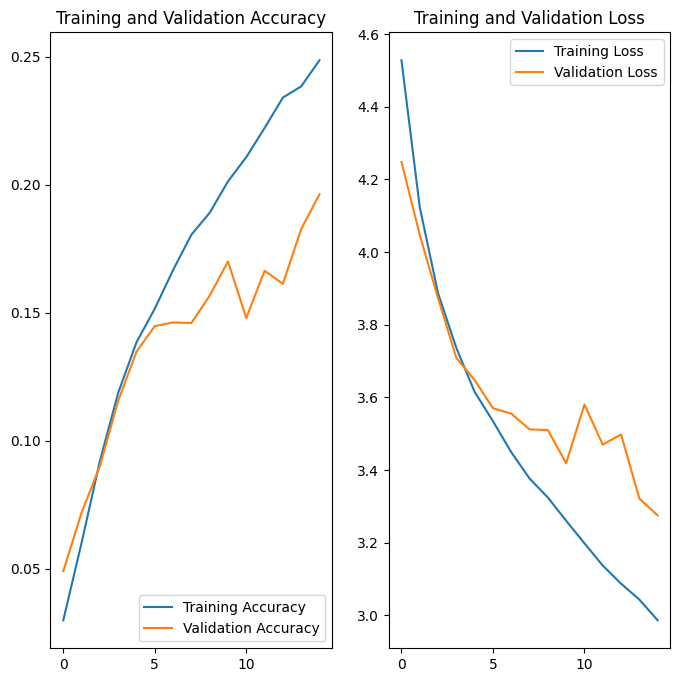

In [62]:
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range(epochs)

plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')
plt.show()

## 新しいデータを予測する

モデルを使用して、トレーニングセットまたは検証セットに含まれていなかった画像を分類します。

注意: データ拡張レイヤーとドロップアウトレイヤーは、推論時に非アクティブになります。

In [76]:
img = tf.keras.utils.load_img('/sumi11.jpg', target_size=(img_height, img_width))

img_array = tf.keras.utils.img_to_array(img)
img_array = tf.expand_dims(img_array, 0) # Create a batch

predictions = model.predict(img_array)
score = tf.nn.softmax(predictions[0])

print(
    "This image most likely belongs to {} with a {:.2f} percent confidence."
    .format(class_names[np.argmax(score)], 100 * np.max(score))
)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
This image most likely belongs to French_bulldog with a 44.87 percent confidence.
